# Object Detection using TAO SSD

Transfer learning is the process of transferring learned features from one application to another. It is a commonly used training technique where you use a model trained on one task and re-train to use it on a different task. 

Train Adapt Optimize (TAO) Toolkit  is a simple and easy-to-use Python based AI toolkit for taking purpose-built AI models and customizing them with users' own data.

<img align="center" src="https://developer.nvidia.com/sites/default/files/akamai/embedded-transfer-learning-toolkit-software-stack-1200x670px.png" width="1080">

## Learning Objectives
In this notebook, you will learn how to leverage the simplicity and convenience of TAO to:

* Take a pretrained resnet18 model and train a ResNet-18 SSD model on the KITTI dataset
* Prune the trained SSD model
* Retrain the pruned model to recover lost accuracy
* Export the pruned model
* Quantize the pruned model using QAT
* Run Inference on the trained model
* Export the pruned, quantized and retrained model to a .etlt file for deployment to DeepStream
* Run inference on the exported. etlt model to verify deployment using TensorRT

## Table of Contents

This notebook shows an example usecase of SSD object detection using Train Adapt Optimize (TAO) Toolkit.

0. [Set up env variables and map drives](#head-0)
1. [Installing the TAO launcher](#head-1)
2. [Prepare dataset and pre-trained model](#head-2) <br>
    2.1 [Download pre-trained model](#head-2-1) <br>
3. [Provide training specification](#head-3)
4. [Run TAO training](#head-4)
5. [Evaluate trained models](#head-5)
6. [Prune trained models](#head-6)
7. [Retrain pruned models](#head-7)
8. [Evaluate retrained model](#head-8)
9. [Visualize inferences](#head-9)
10. [Model Export](#head-10)
11. [Verify deployed model](#head-11)

## 0. Set up env variables and map drives <a class="anchor" id="head-0"></a>

When using the purpose-built pretrained models from NGC, please make sure to set the `$KEY` environment variable to the key as mentioned in the model overview. Failing to do so, can lead to errors when trying to load them as pretrained models.

The following notebook requires the user to set an env variable called the `$LOCAL_PROJECT_DIR` as the path to the users workspace. Please note that the dataset to run this notebook is expected to reside in the `$LOCAL_PROJECT_DIR/data`, while the TAO experiment generated collaterals will be output to `$LOCAL_PROJECT_DIR/ssd`. More information on how to set up the dataset and the supported steps in the TAO workflow are provided in the subsequent cells.

*Note: Please make sure to remove any stray artifacts/files from the `$USER_EXPERIMENT_DIR` or `$DATA_DOWNLOAD_DIR` paths as mentioned below, that may have been generated from previous experiments. Having checkpoint files etc may interfere with creating a training graph for a new experiment.*


In [1]:
# Setting up env variables for cleaner command line commands.
import os

print("Please replace the variable with your key.")
%env KEY=nvidia_tlt
%env GPU_INDEX=0
%env USER_EXPERIMENT_DIR=/workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd
%env DATA_DOWNLOAD_DIR=/workspace/tao-experiments/myData/MOTDet

# Please define this local project directory that needs to be mapped to the TAO docker session.
# The dataset expected to be present in $LOCAL_PROJECT_DIR/data, while the results for the steps
# in this notebook will be stored at $LOCAL_PROJECT_DIR/ssd
# %env LOCAL_PROJECT_DIR=/data/tlt-experiments
%env LOCAL_PROJECT_DIR=/home/tako/kjh/workspace/cv_samples_v1.3.0

os.environ["LOCAL_DATA_DIR"] = os.path.join(os.getenv("LOCAL_PROJECT_DIR", os.getcwd()), "myData", "MOTDet")
os.environ["LOCAL_EXPERIMENT_DIR"] = os.path.join(os.getenv("LOCAL_PROJECT_DIR", os.getcwd()), "my_tao_cv_sample", "myMotWithSsd")

# Set this path if you don't run the notebook from the samples directory.
# %env NOTEBOOK_ROOT=/data/tlt-experiments/ssd
# The sample spec files are present in the same path as the downloaded samples.
os.environ["LOCAL_SPECS_DIR"] = os.path.join(
    os.getenv("NOTEBOOK_ROOT", os.getcwd()),
    "specs"
)
# %env SPECS_DIR=/workspace/tao-experiments/ssd/specs
%env SPECS_DIR=/workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd/specs

# Showing list of specification files.
!ls -rlt $LOCAL_SPECS_DIR

Please replace the variable with your key.
env: KEY=nvidia_tlt
env: GPU_INDEX=0
env: USER_EXPERIMENT_DIR=/workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd
env: DATA_DOWNLOAD_DIR=/workspace/tao-experiments/myData/MOTDet
env: LOCAL_PROJECT_DIR=/home/tako/kjh/workspace/cv_samples_v1.3.0
env: SPECS_DIR=/workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd/specs
total 20
-rw-rw-r-- 1 tako tako 1328  1월 18 09:23 ssd_train_resnet18_kitti.txt
-rw-rw-r-- 1 tako tako 1312  1월 20 08:30 ssd_retrain_resnet18_kitti.txt
-rw-rw-r-- 1 tako tako 1393  1월 20 08:30 ssd_retrain_resnet18_kitti_seq.txt
-rw-rw-r-- 1 tako tako 1409  1월 20 08:32 ssd_train_resnet18_kitti_seq.txt
-rw-rw-r-- 1 tako tako  387  1월 24 13:04 ssd_tfrecords_kitti_train.txt


The cell below maps the project directory on your local host to a workspace directory in the TAO docker instance, so that the data and the results are mapped from in and out of the docker. For more information please refer to the [launcher instance](https://docs.nvidia.com/tao/tao-toolkit/tao_launcher.html) in the user guide.

When running this cell on AWS, update the drive_map entry with the dictionary defined below, so that you don't have permission issues when writing data into folders created by the TAO docker.

```json
drive_map = {
    "Mounts": [
            # Mapping the data directory
            {
                "source": os.environ["LOCAL_PROJECT_DIR"],
                "destination": "/workspace/tao-experiments"
            },
            # Mapping the specs directory.
            {
                "source": os.environ["LOCAL_SPECS_DIR"],
                "destination": os.environ["SPECS_DIR"]
            },
        ],
    "DockerOptions": {
        "user": "{}:{}".format(os.getuid(), os.getgid())
    }
}
```

In [2]:
# Mapping up the local directories to the TAO docker.
import json
mounts_file = os.path.expanduser("~/.tao_mounts.json")

# Define the dictionary with the mapped drives
drive_map = {
    "Mounts": [
            # Mapping the data directory
            {
                "source": os.environ["LOCAL_PROJECT_DIR"],
                "destination": "/workspace/tao-experiments"
            },
            # Mapping the specs directory.
            {
                "source": os.environ["LOCAL_SPECS_DIR"],
                "destination": os.environ["SPECS_DIR"]
            },
        ],
    "DockerOptions": {
        "user": "{}:{}".format(os.getuid(), os.getgid())
    }
}

# Writing the mounts file.
with open(mounts_file, "w") as mfile:
    json.dump(drive_map, mfile, indent=4)

In [3]:
!cat ~/.tao_mounts.json

{
    "Mounts": [
        {
            "source": "/home/tako/kjh/workspace/cv_samples_v1.3.0",
            "destination": "/workspace/tao-experiments"
        },
        {
            "source": "/home/tako/kjh/workspace/cv_samples_v1.3.0/my_tao_cv_sample/myMotWithSsd/specs",
            "destination": "/workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd/specs"
        }
    ],
    "DockerOptions": {
        "user": "1000:1000"
    }
}

In [4]:
!ls $LOCAL_SPECS_DIR

ssd_retrain_resnet18_kitti_seq.txt  ssd_train_resnet18_kitti_seq.txt
ssd_retrain_resnet18_kitti.txt	    ssd_train_resnet18_kitti.txt
ssd_tfrecords_kitti_train.txt


## 1. Installing the TAO launcher <a class="anchor" id="head-1"></a>
The TAO launcher is a python package distributed as a python wheel listed in the `nvidia-pyindex` python index. You may install the launcher by executing the following cell.

Please note that TAO Toolkit recommends users to run the TAO launcher in a virtual env with python 3.6.9. You may follow the instruction in this [page](https://virtualenvwrapper.readthedocs.io/en/latest/install.html) to set up a python virtual env using the `virtualenv` and `virtualenvwrapper` packages. Once you have setup virtualenvwrapper, please set the version of python to be used in the virtual env by using the `VIRTUALENVWRAPPER_PYTHON` variable. You may do so by running

```sh
export VIRTUALENVWRAPPER_PYTHON=/path/to/bin/python3.x
```
where x >= 6 and <= 8

We recommend performing this step first and then launching the notebook from the virtual environment. In addition to installing TAO python package, please make sure of the following software requirements:
* python >=3.6.9 < 3.8.x
* docker-ce > 19.03.5
* docker-API 1.40
* nvidia-container-toolkit > 1.3.0-1
* nvidia-container-runtime > 3.4.0-1
* nvidia-docker2 > 2.5.0-1
* nvidia-driver > 455+

Once you have installed the pre-requisites, please log in to the docker registry nvcr.io by following the command below

```sh
docker login nvcr.io
```

You will be triggered to enter a username and password. The username is `$oauthtoken` and the password is the API key generated from `ngc.nvidia.com`. Please follow the instructions in the [NGC setup guide](https://docs.nvidia.com/ngc/ngc-overview/index.html#generating-api-key) to generate your own API key.

Please note that TAO Toolkit recommends users to run the TAO launcher in a virtual env with python >=3.6.9. You may follow the instruction in this [page](https://virtualenvwrapper.readthedocs.io/en/latest/install.html) to set up a python virtual env using the virtualenv and virtualenvwrapper packages.

In [4]:
# SKIP this step IF you have already installed the TAO launcher.
!pip3 install nvidia-pyindex
!pip3 install nvidia-tao

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


In [5]:
# View the versions of the TAO launcher
!tao info

Configuration of the TAO Toolkit Instance
dockers: ['nvidia/tao/tao-toolkit-tf', 'nvidia/tao/tao-toolkit-pyt', 'nvidia/tao/tao-toolkit-lm']
format_version: 2.0
toolkit_version: 3.21.11
published_date: 11/08/2021


## 2. Prepare dataset and pre-trained model <a class="anchor" id="head-2"></a>

학습 시킬 MOT 데이터를 준비하세요.
COCO dataset으로 변환된 MOT 데이터를 이용해서 Kitti로 변환합니다.

In [6]:
!echo $LOCAL_DATA_DIR
!echo $LOCAL_EXPERIMENT_DIR

# Create local dir
!mkdir -p $LOCAL_DATA_DIR
!mkdir -p $LOCAL_EXPERIMENT_DIR

/home/tako/kjh/workspace/cv_samples_v1.3.0/myData/MOTDet
/home/tako/kjh/workspace/cv_samples_v1.3.0/my_tao_cv_sample/myMotWithSsd


In [7]:
!echo $LOCAL_DATA_DIR/
# verify
!ls -l $LOCAL_DATA_DIR/

/home/tako/kjh/workspace/cv_samples_v1.3.0/myData/MOTDet/
total 20
drwxrwxr-x 2 tako tako   52  1월 24 10:24 annotations
-rw-rw-r-- 1 tako tako 3320  1월 24 10:26 coco2kitti.py
-rw-rw-r-- 1 tako tako  912  1월 18 09:31 draw.py
drwxrwxr-x 4 tako tako   63  1월 18 09:30 MOT17-02
drwxrwxr-x 4 tako tako   63  1월 18 09:30 MOT17-04
drwxrwxr-x 4 tako tako   63  1월 18 09:30 MOT17-09
drwxrwxr-x 4 tako tako   63  1월 18 09:30 MOT17-10
drwxrwxr-x 4 tako tako   63  1월 18 09:30 MOT17-13
drwxrwx--- 4 tako tako   63  1월 18 09:30 MOT20-01
drwxrwx--- 4 tako tako   63  1월 18 09:30 MOT20-02
drwxrwx--- 4 tako tako   63  1월 18 09:30 MOT20-03
drwxrwx--- 4 tako tako   63  1월 18 09:30 MOT20-05
-rw-rw-r-- 1 tako tako 3267  1월 24 10:22 mot2coco.py
-rw-rw-r-- 1 tako tako 1019  1월 18 09:31 rename_mot.py
-rw-rw-r-- 1 tako tako  132  1월 18 09:31 test.py
drwxrwxr-x 4 tako tako   45  1월 24 10:26 train
drwxrwxr-x 4 tako tako   45  1월 24 10:26 val


In [8]:
print("TFRecords conversion spec file:")
!cat $LOCAL_SPECS_DIR/ssd_tfrecords_kitti_train.txt

TFRecords conversion spec file:
kitti_config {
  root_directory_path: "/workspace/tao-experiments/myData/MOTDet/train"
  image_dir_name: "image"
  label_dir_name: "labels"
  image_extension: ".jpg"
  partition_mode: "random"
  num_partitions: 2
  val_split: 0
  num_shards: 10
}
image_directory_path: "/workspace/tao-experiments/myData/MOTDet/train/image"
target_class_mapping {
    key: "person"
    value: "person"
}


In [13]:
# Creating a new directory for the output tfrecords dump.
print("Converting the training set to TFRecords.")
!mkdir -p $LOCAL_DATA_DIR/tfrecords && rm -rf $LOCAL_DATA_DIR/tfrecords/*
!tao ssd dataset_convert \
         -d $SPECS_DIR/ssd_tfrecords_kitti_train.txt \
         -o $DATA_DOWNLOAD_DIR/tfrecords/kitti_train

Converting the training set to TFRecords.
2022-01-24 13:04:33,101 [INFO] root: Registry: ['nvcr.io']
2022-01-24 13:04:33,253 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-wb3dis1c because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2022-01-24 04:04:41,474 [INFO] iva.detectnet_v2.dataio.build_converter: Instantiating a kitti converter
2022-01-24 04:04:41,474 [INFO] root: Instantiating a kitti converter
2022-01-24 04:04:41,475 [INFO] root: Generating partitions
2022-01-24 04:04:41,500 [INFO] iva.detectnet_v2.dataio.kitti_converter_lib: Num images in
Train: 9676	Val: 

In [14]:
!ls -rlt $LOCAL_DATA_DIR/tfrecords/

total 3182600
-rw-r--r-- 1 tako tako 326176515  1월 24 13:04 kitti_train-fold-000-of-002-shard-00000-of-00010
-rw-r--r-- 1 tako tako 322547595  1월 24 13:04 kitti_train-fold-000-of-002-shard-00001-of-00010
-rw-r--r-- 1 tako tako 323472074  1월 24 13:04 kitti_train-fold-000-of-002-shard-00002-of-00010
-rw-r--r-- 1 tako tako 328766232  1월 24 13:04 kitti_train-fold-000-of-002-shard-00003-of-00010
-rw-r--r-- 1 tako tako 321879640  1월 24 13:04 kitti_train-fold-000-of-002-shard-00004-of-00010
-rw-r--r-- 1 tako tako 330510495  1월 24 13:05 kitti_train-fold-000-of-002-shard-00005-of-00010
-rw-r--r-- 1 tako tako 321791560  1월 24 13:05 kitti_train-fold-000-of-002-shard-00006-of-00010
-rw-r--r-- 1 tako tako 326940109  1월 24 13:05 kitti_train-fold-000-of-002-shard-00007-of-00010
-rw-r--r-- 1 tako tako 327032010  1월 24 13:05 kitti_train-fold-000-of-002-shard-00008-of-00010
-rw-r--r-- 1 tako tako 329685895  1월 24 13:05 kitti_train-fold-000-of-002-shard-00009-of-00010
-rw-r--r-- 1 tako tako     16105  1월

Additionally, if you have your own dataset already in a volume (or folder), you can mount the volume on `LOCAL_DATA_DIR` (or create a soft link). Below shows an example:
```bash
# if your dataset is in /dev/sdc1
mount /dev/sdc1 $LOCAL_DATA_DIR

# if your dataset is in folder /var/dataset
ln -sf /var/dataset $LOCAL_DATA_DIR
```

### 2.1 Download pre-trained model <a class="anchor" id="head-2-1"></a>

We will use NGC CLI to get the pre-trained models. For more details, go to [ngc.nvidia.com](ngc.nvidia.com) and click the SETUP on the navigation bar.

In [15]:
!echo $LOCAL_PROJECT_DIR

# Installing NGC CLI on the local machine.
## Download and install
%env CLI=ngccli_cat_linux.zip
!mkdir -p $LOCAL_PROJECT_DIR/ngccli

# Remove any previously existing CLI installations
!rm -rf $LOCAL_PROJECT_DIR/ngccli/*
!wget "https://ngc.nvidia.com/downloads/$CLI" -P $LOCAL_PROJECT_DIR/ngccli
!unzip -u "$LOCAL_PROJECT_DIR/ngccli/$CLI" -d $LOCAL_PROJECT_DIR/ngccli/
!rm $LOCAL_PROJECT_DIR/ngccli/*.zip 
os.environ["PATH"]="{}/ngccli:{}".format(os.getenv("LOCAL_PROJECT_DIR", ""), os.getenv("PATH", ""))

/home/tako/kjh/workspace/cv_samples_v1.3.0
env: CLI=ngccli_cat_linux.zip
--2022-01-24 13:08:33--  https://ngc.nvidia.com/downloads/ngccli_cat_linux.zip
Resolving ngc.nvidia.com (ngc.nvidia.com)... 13.225.134.50, 13.225.134.61, 13.225.134.64, ...
Connecting to ngc.nvidia.com (ngc.nvidia.com)|13.225.134.50|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 25206525 (24M) [application/zip]
Saving to: ‘/home/tako/kjh/workspace/cv_samples_v1.3.0/ngccli/ngccli_cat_linux.zip’

ngccli_cat_linux.zi 100%[===================>]  24.04M  9.18MB/s    in 2.6s    

2022-01-24 13:08:36 (9.18 MB/s) - ‘/home/tako/kjh/workspace/cv_samples_v1.3.0/ngccli/ngccli_cat_linux.zip’ saved [25206525/25206525]

Archive:  /home/tako/kjh/workspace/cv_samples_v1.3.0/ngccli/ngccli_cat_linux.zip
  inflating: /home/tako/kjh/workspace/cv_samples_v1.3.0/ngccli/ngc  
 extracting: /home/tako/kjh/workspace/cv_samples_v1.3.0/ngccli/ngc.md5  


In [16]:
!ngc registry model list nvidia/tao/pretrained_object_detection:*

+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| Versi | Accur | Epoch | Batch | GPU   | Memor | File  | Statu | Creat |
| on    | acy   | s     | Size  | Model | y Foo | Size  | s     | ed    |
|       |       |       |       |       | tprin |       |       | Date  |
|       |       |       |       |       | t     |       |       |       |
+-------+-------+-------+-------+-------+-------+-------+-------+-------+
| vgg19 | 77.56 | 80    | 1     | V100  | 153.7 | 153.7 | UPLOA | Aug   |
|       |       |       |       |       |       | 2 MB  | D_COM | 18,   |
|       |       |       |       |       |       |       | PLETE | 2021  |
| vgg16 | 77.17 | 80    | 1     | V100  | 113.2 | 113.1 | UPLOA | Aug   |
|       |       |       |       |       |       | 6 MB  | D_COM | 18,   |
|       |       |       |       |       |       |       | PLETE | 2021  |
| squee | 65.13 | 80    | 1     | V100  | 6.5   | 6.46  | UPLOA | Aug   |
| zenet |       |       |       |     

In [17]:
!echo $LOCAL_EXPERIMENT_DIR

!mkdir -p $LOCAL_EXPERIMENT_DIR/pretrained_resnet18/

/home/tako/kjh/workspace/cv_samples_v1.3.0/my_tao_cv_sample/myMotWithSsd


In [18]:
# Pull pretrained model from NGC
!ngc registry model download-version nvidia/tao/pretrained_object_detection:resnet18 --dest $LOCAL_EXPERIMENT_DIR/pretrained_resnet18

Downloaded 82.38 MB in 3m 28s, Download speed: 405.03 KB/s               
----------------------------------------------------
Transfer id: pretrained_object_detection_vresnet18 Download status: Completed.
Downloaded local path: /home/tako/kjh/workspace/cv_samples_v1.3.0/my_tao_cv_sample/myMotWithSsd/pretrained_resnet18/pretrained_object_detection_vresnet18-1
Total files downloaded: 1 
Total downloaded size: 82.38 MB
Started at: 2022-01-24 13:11:18.337491
Completed at: 2022-01-24 13:14:46.620718
Duration taken: 3m 28s
----------------------------------------------------


In [19]:
print("Check that model is downloaded into dir.")
!ls -l $LOCAL_EXPERIMENT_DIR/pretrained_resnet18/pretrained_object_detection_vresnet18

Check that model is downloaded into dir.
total 91096
-rw------- 1 tako tako 93278448  1월 18 10:20 resnet_18.hdf5


## 3. Provide training specification <a class="anchor" id="head-3"></a>
* Dataset for the train datasets
    * In order to use the newly generated dataset, update the dataset_config parameter in the spec file at `$LOCAL_SPECS_DIR/ssd_train_resnet18_kitti.txt` 
* Augmentation parameters for on the fly data augmentation
* Other training (hyper-)parameters such as batch size, number of epochs, learning rate etc.
* Whether to use quantization aware training (QAT)

In [17]:
# To enable QAT training on sample spec file, uncomment following lines
# !sed -i "s/enable_qat: false/enable_qat: true/g" $LOCAL_SPECS_DIR/ssd_train_resnet18_kitti.txt
# !sed -i "s/enable_qat: false/enable_qat: true/g" $LOCAL_SPECS_DIR/ssd_retrain_resnet18_kitti.txt

In [18]:
# By default, the sample spec file disables QAT training. You can force non-QAT training by running lines below
# !sed -i "s/enable_qat: true/enable_qat: false/g" $LOCAL_SPECS_DIR/ssd_train_resnet18_kitti.txt
# !sed -i "s/enable_qat: true/enable_qat: false/g" $LOCAL_SPECS_DIR/ssd_retrain_resnet18_kitti.txt

In [20]:
!cat $LOCAL_SPECS_DIR/ssd_train_resnet18_kitti.txt

## 4. Run TAO training <a class="anchor" id="head-4"></a>
* Provide the sample spec file and the output directory location for models
* WARNING: training will take several hours or one day to complete

In [5]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_unpruned

In [6]:
print("To run with multigpu, please change --gpus based on the number of available GPUs in your machine.")
!tao ssd train --gpus 1 --gpu_index=$GPU_INDEX \
               -e $SPECS_DIR/ssd_train_resnet18_kitti.txt \
               -r $USER_EXPERIMENT_DIR/experiment_dir_unpruned \
               -k $KEY \
               -m $USER_EXPERIMENT_DIR/pretrained_resnet18/pretrained_object_detection_vresnet18/resnet_18.hdf5

To run with multigpu, please change --gpus based on the number of available GPUs in your machine.
2022-01-24 13:30:58,073 [INFO] root: Registry: ['nvcr.io']
2022-01-24 13:30:58,221 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-9orx12a2 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.

2022-01-24 04:31:08,403 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/ed34e6d125608f91724fda23656f1726/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_wheel.runfiles/ai_infra/iva/ssd/scripts/train.py:64: The name tf.ConfigProto is deprecated. Plea

In [9]:
print("To resume from checkpoint, please uncomment and run this instead. Change last two arguments accordingly.")
# !tao ssd train --gpus 1 --gpu_index=$GPU_INDEX \
#                -e $SPECS_DIR/ssd_train_resnet18_kitti.txt \
#                -r $USER_EXPERIMENT_DIR/experiment_dir_unpruned \
#                -k $KEY \
#                -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/ssd_resnet18_epoch_001.tlt \
#                --initial_epoch 2

To resume from checkpoint, please uncomment and run this instead. Change last two arguments accordingly.


In [7]:
print('Model for each epoch:')
print('---------------------')
!ls -ltrh $LOCAL_EXPERIMENT_DIR/experiment_dir_unpruned/weights

Model for each epoch:
---------------------
total 7.9G
-rw-r--r-- 1 tako tako 101M  1월 24 13:36 ssd_resnet18_epoch_001.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:38 ssd_resnet18_epoch_002.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:40 ssd_resnet18_epoch_003.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:42 ssd_resnet18_epoch_004.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:45 ssd_resnet18_epoch_005.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:47 ssd_resnet18_epoch_006.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:49 ssd_resnet18_epoch_007.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:51 ssd_resnet18_epoch_008.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:54 ssd_resnet18_epoch_009.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 13:56 ssd_resnet18_epoch_010.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 14:01 ssd_resnet18_epoch_011.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 14:03 ssd_resnet18_epoch_012.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 14:06 ssd_resnet18_epoch_013.tlt
-rw-r--r-- 1 tako tako 101M  1월 24 14:08 ssd_resnet18_epoch_0

In [8]:
# Now check the evaluation stats in the csv file and pick the model with highest eval accuracy.
!cat $LOCAL_EXPERIMENT_DIR/experiment_dir_unpruned/ssd_training_log_resnet18.csv
%set_env EPOCH=080

epoch,AP_person,loss,lr,mAP,validation_loss
1,nan,15.96826,8.2377446e-05,nan,nan
2,nan,12.8869295,0.00013572087,nan,nan
3,nan,12.004454,0.00022360678,nan,nan
4,nan,11.466866,0.00036840313,nan,nan
5,nan,11.10472,0.00060696213,nan,nan
6,nan,10.800692,0.0009999998,nan,nan
7,nan,10.502644,0.0016475488,nan,nan
8,nan,10.203291,0.0027144172,nan,nan
9,nan,9.815844,0.004472135,nan,nan
10,0.5402867487941663,9.283814,0.007368061,0.5402867487941663,59.16707520023903
11,nan,8.749585,0.012139242,nan,nan
12,nan,7.9889936,0.019999994,nan,nan
13,nan,7.048286,0.02,nan,nan
14,nan,6.274226,0.02,nan,nan
15,nan,5.6461067,0.02,nan,nan
16,nan,5.2063756,0.02,nan,nan
17,nan,4.9142876,0.02,nan,nan
18,nan,4.689982,0.02,nan,nan
19,nan,4.473635,0.02,nan,nan
20,0.7142075790500352,4.386975,0.02,0.7142075790500352,51.16360334047736
21,nan,4.245656,0.02,nan,nan
22,nan,4.1587853,0.02,nan,nan
23,nan,4.052785,0.02,nan,nan
24,nan,3.9966335,0.02,nan,nan
25,nan,3.9407313,0.02,nan,nan
26,nan,3.9077172,0.02,nan,nan
27,nan,3.86

## 5. Evaluate trained models <a class="anchor" id="head-5"></a>

In [11]:
!echo $GPU_INDEX

0


In [10]:
!tao ssd evaluate --gpu_index=$GPU_INDEX \
    -e $SPECS_DIR/ssd_train_resnet18_kitti.txt \
    -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/ssd_resnet18_epoch_$EPOCH.tlt \
    -k $KEY

2022-01-24 17:22:31,821 [INFO] root: Registry: ['nvcr.io']
2022-01-24 17:22:31,980 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-33afgbt2 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2022-01-24 08:22:40,709 [INFO] iva.ssd.utils.spec_loader: Merging specification from /workspace/tao-experiments/my_tao_cv_sample/myMotWithSsd/specs/ssd_train_resnet18_kitti.txt

2022-01-24 08:22:40,712 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.re

## 6. Prune trained models <a class="anchor" id="head-6"></a>
* Specify pre-trained model
* Equalization criterion (`Only for resnets as they have element wise operations or MobileNets.`)
* Threshold for pruning.
* A key to save and load the model
* Output directory to store the model

Usually, you just need to adjust `-pth` (threshold) for accuracy and model size trade off. Higher `pth` gives you smaller model (and thus higher inference speed) but worse accuracy. The threshold value depends on the dataset and the model. `0.5` in the block below is just a start point. If the retrain accuracy is good, you can increase this value to get smaller models. Otherwise, lower this value to get better accuracy.

In [12]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned

In [13]:
!tao ssd prune --gpu_index=$GPU_INDEX \
               -m $USER_EXPERIMENT_DIR/experiment_dir_unpruned/weights/ssd_resnet18_epoch_$EPOCH.tlt \
               -o $USER_EXPERIMENT_DIR/experiment_dir_pruned/ssd_resnet18_pruned.tlt \
               -eq intersection \
               -pth 0.1 \
               -k $KEY

2022-01-24 17:29:58,034 [INFO] root: Registry: ['nvcr.io']
2022-01-24 17:29:58,165 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-g87nr8t7 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2022-01-24 08:30:13,819 [INFO] modulus.pruning.pruning: Exploring graph for retainable indices
2022-01-24 08:30:16,871 [INFO] modulus.pruning.pruning: Pruning model and appending pruned nodes to new graph
2022-01-24 08:31:25,850 [INFO] iva.common.magnet_prune: Pruning ratio (pruned model / original model): 0.16711811964120868
2022-01-24 08:31:26,424 [INFO] root: Pruning ratio (p

In [14]:
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_pruned/

total 8988
-rw-r--r-- 1 tako tako 9202136  1월 24 17:31 ssd_resnet18_pruned.tlt


## 7. Retrain pruned models <a class="anchor" id="head-7"></a>
* Model needs to be re-trained to bring back accuracy after pruning
* Specify re-training specification
* WARNING: training will take several hours or one day to complete

In [15]:
# Printing the retrain spec file. 
# Here we have updated the spec file to include the newly pruned model as a pretrained weights.
!cat $LOCAL_SPECS_DIR/ssd_retrain_resnet18_kitti.txt

random_seed: 42
ssd_config {
  aspect_ratios_global: "[1.0, 2.0, 0.5, 3.0, 1.0/3.0]"
  scales: "[0.05, 0.1, 0.25, 0.4, 0.55, 0.7, 0.85]"
  two_boxes_for_ar1: true
  clip_boxes: false
  variances: "[0.1, 0.1, 0.2, 0.2]"
  arch: "resnet"
  nlayers: 18
  freeze_bn: false
}
training_config {
  batch_size_per_gpu: 32
  num_epochs: 80
  enable_qat: false
  learning_rate {
  soft_start_annealing_schedule {
    min_learning_rate: 5e-5
    max_learning_rate: 2e-2
    soft_start: 0.1
    annealing: 0.6
    }
  }
  regularizer {
    type: NO_REG
    weight: 3e-9
  }
}
eval_config {
  validation_period_during_training: 10
  average_precision_mode: SAMPLE
  batch_size: 32
  matching_iou_threshold: 0.5
}
nms_config {
  confidence_threshold: 0.01
  clustering_iou_threshold: 0.6
  top_k: 200
}
augmentation_config {
    output_width: 300
    output_height: 300
    output_channel: 3
}
dataset_config {
  data_sources: {
    tfrecords_path: "/workspace/tao-experiments/myData/MOTDet/tfrecords/kitti_train*"

In [16]:
!mkdir -p $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain

In [17]:
# Retraining using the pruned model as pretrained weights 
!tao ssd train --gpus 1 --gpu_index=$GPU_INDEX \
               -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
               -r $USER_EXPERIMENT_DIR/experiment_dir_retrain \
               -m $USER_EXPERIMENT_DIR/experiment_dir_pruned/ssd_resnet18_pruned.tlt \
               -k $KEY

2022-01-24 17:34:09,408 [INFO] root: Registry: ['nvcr.io']
2022-01-24 17:34:09,542 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-1eqvfbwv because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.

2022-01-24 08:34:20,024 [WARNING] tensorflow: From /root/.cache/bazel/_bazel_root/ed34e6d125608f91724fda23656f1726/execroot/ai_infra/bazel-out/k8-fastbuild/bin/magnet/packages/iva/build_wheel.runfiles/ai_infra/iva/ssd/scripts/train.py:64: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.


2022-01-24 08:34:20,025 [WARNING] tensorflow: From /roo

In [ ]:
# Listing the newly retrained model.
!ls -rlt $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain/weights

total 1691200
-rw-r--r-- 1 demo demo 21643880 12월 20 14:56 ssd_resnet18_epoch_001.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 14:57 ssd_resnet18_epoch_002.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 14:57 ssd_resnet18_epoch_003.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 14:58 ssd_resnet18_epoch_004.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 14:59 ssd_resnet18_epoch_005.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 14:59 ssd_resnet18_epoch_006.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:00 ssd_resnet18_epoch_007.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:00 ssd_resnet18_epoch_008.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:01 ssd_resnet18_epoch_009.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:01 ssd_resnet18_epoch_010.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:02 ssd_resnet18_epoch_011.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:03 ssd_resnet18_epoch_012.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:03 ssd_resnet18_epoch_013.tlt
-rw-r--r-- 1 demo demo 21643880 12월 20 15:04 ssd_r

In [ ]:
# Now check the evaluation stats in the csv file and pick the model with highest eval accuracy.
!cat $LOCAL_EXPERIMENT_DIR/experiment_dir_retrain/ssd_training_log_resnet18.csv
%set_env EPOCH=080

epoch,AP_car,AP_cyclist,AP_pedestrian,loss,lr,mAP,validation_loss
1,nan,nan,nan,4.152668,0.00010573712,nan,nan
2,nan,nan,nan,2.8581555,0.00022360678,nan,nan
3,nan,nan,nan,2.7843575,0.00047287077,nan,nan
4,nan,nan,nan,2.7614615,0.0009999999,nan,nan
5,nan,nan,nan,2.7401767,0.0021147423,nan,nan
6,nan,nan,nan,2.7250664,0.0044721356,nan,nan
7,nan,nan,nan,2.738672,0.009457415,nan,nan
8,nan,nan,nan,2.812125,0.019999998,nan,nan
9,nan,nan,nan,2.8978367,0.02,nan,nan
10,0.8438585251947927,0.2823235753367546,0.3766156451096302,2.857075,0.02,0.5009325818803925,76.05292449787976
11,nan,nan,nan,2.8707504,0.02,nan,nan
12,nan,nan,nan,2.860326,0.02,nan,nan
13,nan,nan,nan,2.8436902,0.02,nan,nan
14,nan,nan,nan,2.798987,0.02,nan,nan
15,nan,nan,nan,2.7968154,0.02,nan,nan
16,nan,nan,nan,2.796909,0.02,nan,nan
17,nan,nan,nan,2.7865753,0.02,nan,nan
18,nan,nan,nan,2.7876124,0.02,nan,nan
19,nan,nan,nan,2.778655,0.02,nan,nan
20,0.8399911306668539,0.2782208670999492,0.42136012357742225,2.7829034,0.02,0.513190707114

## 8. Evaluate retrained model <a class="anchor" id="head-8"></a>

In [ ]:
!ls $LOCAL_SPECS_DIR
!cat $SPECS_DIR/ssd_retrain_resnet18_kitti.txt

ssd_retrain_resnet18_kitti_seq.txt  ssd_train_resnet18_kitti_seq.txt
ssd_retrain_resnet18_kitti.txt	    ssd_train_resnet18_kitti.txt
ssd_tfrecords_kitti_train.txt
cat: /workspace/tao-experiments/ssd/specs/ssd_retrain_resnet18_kitti.txt: No such file or directory


In [ ]:
!tao ssd evaluate --gpu_index=$GPU_INDEX \
                  -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
                  -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/ssd_resnet18_epoch_$EPOCH.tlt \
                  -k $KEY

2021-12-20 15:47:30,401 [INFO] root: Registry: ['nvcr.io']
2021-12-20 15:47:30,448 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-3irvyk7_ because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2021-12-20 06:47:35,637 [INFO] iva.ssd.utils.spec_loader: Merging specification from /workspace/tao-experiments/ssd/specs/ssd_retrain_resnet18_kitti.txt

2021-12-20 06:47:35,639 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.reset_default_graph instea

Using TLT model for inference, setting batch size to the one in eval_config: 32
Producing predictions: 100%|████████████████████| 24/24 [00:07<00:00,  3.35it/s]
Start to calculate AP for each class
*******************************
car           AP    0.874
cyclist       AP    0.549
pedestrian    AP    0.531
              mAP   0.651
*******************************
terminate called without an active exception
Aborted (core dumped)
2021-12-20 15:49:37,598 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


## 9. Visualize inferences <a class="anchor" id="head-9"></a>
In this section, we run the `infer` tool to generate inferences on the trained models and visualize the results.

In [ ]:
# Copy some test images
!mkdir -p $LOCAL_DATA_DIR/test_samples
!cp $LOCAL_DATA_DIR/testing/image_2/00000* $LOCAL_DATA_DIR/test_samples

In [ ]:
# Running inference for detection on n images
!tao ssd inference --gpu_index=$GPU_INDEX -i $DATA_DOWNLOAD_DIR/test_samples \
                   -o $USER_EXPERIMENT_DIR/ssd_infer_images \
                   -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
                   -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/ssd_resnet18_epoch_$EPOCH.tlt \
                   -l $USER_EXPERIMENT_DIR/ssd_infer_labels \
                   -k $KEY

2021-12-20 15:50:20,173 [INFO] root: Registry: ['nvcr.io']
2021-12-20 15:50:20,217 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-7u6_sg68 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2021-12-20 06:50:25,138 [INFO] iva.ssd.utils.spec_loader: Merging specification from /workspace/tao-experiments/ssd/specs/ssd_retrain_resnet18_kitti.txt

2021-12-20 06:50:25,140 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.reset_default_graph instea

Using TLT model for inference, setting batch size to the one in eval_config: 32
100%|█████████████████████████████████████████████| 1/1 [00:03<00:00,  3.70s/it]
2021-12-20 15:52:20,029 [INFO] tlt.components.docker_handler.docker_handler: Stopping container.


The `tao` inference tool produces two outputs. 
1. Overlain images in `$USER_EXPERIMENT_DIR/ssd_infer_images`
2. Frame by frame bbox labels in kitti format located in `$USER_EXPERIMENT_DIR/ssd_infer_labels`

In [ ]:
# Simple grid visualizer
!pip3 install matplotlib==3.3.3
import matplotlib.pyplot as plt
import os
from math import ceil
valid_image_ext = ['.jpg', '.png', '.jpeg', '.ppm']

def visualize_images(image_dir, num_cols=4, num_images=10):
    output_path = os.path.join(os.environ['LOCAL_EXPERIMENT_DIR'], image_dir)
    num_rows = int(ceil(float(num_images) / float(num_cols)))
    f, axarr = plt.subplots(num_rows, num_cols, figsize=[80,30])
    f.tight_layout()
    a = [os.path.join(output_path, image) for image in os.listdir(output_path) 
         if os.path.splitext(image)[1].lower() in valid_image_ext]
    for idx, img_path in enumerate(a[:num_images]):
        col_id = idx % num_cols
        row_id = idx // num_cols
        img = plt.imread(img_path)
        axarr[row_id, col_id].imshow(img) 

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com


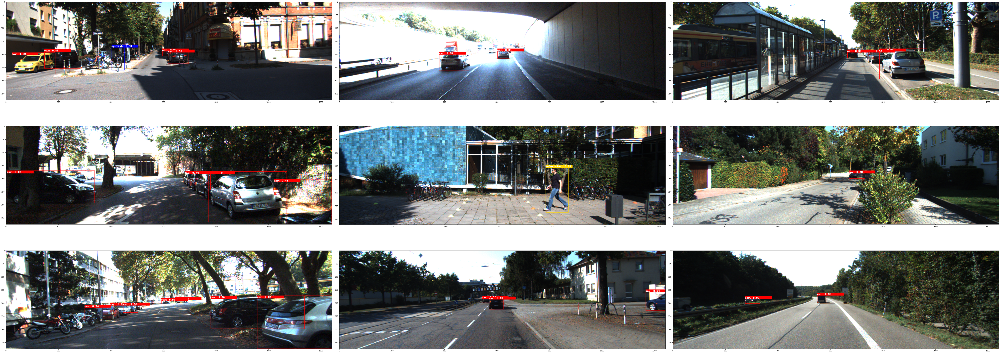

In [ ]:
# Visualizing the sample images.
OUTPUT_PATH = 'ssd_infer_images' # relative path from $USER_EXPERIMENT_DIR.
COLS = 3 # number of columns in the visualizer grid.
IMAGES = 9 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)

## 10. Model Export <a class="anchor" id="head-10"></a>

If you trained a non-QAT model, you may export in FP32, FP16 or INT8 mode using the code block below. For INT8, you need to provide calibration image directory.

In [ ]:
# tao <task> export will fail if .etlt already exists. So we clear the export folder before tao <task> export
!rm -rf $LOCAL_EXPERIMENT_DIR/export
!mkdir -p $LOCAL_EXPERIMENT_DIR/export
# Export in FP32 mode. Change --data_type to fp16 for FP16 mode
!tao ssd export --gpu_index=$GPU_INDEX \
                -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/ssd_resnet18_epoch_$EPOCH.tlt \
                -k $KEY \
                -o $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt \
                -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
                --batch_size 16 \
                --data_type fp32 \
                --gen_ds_config

# Uncomment to export in INT8 mode (generate calibration cache file).
# !tao ssd export --gpu_index=$GPU_INDEX \
#                 -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/ssd_resnet18_epoch_$EPOCH.tlt  \
#                 -o $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt \
#                 -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
#                 -k $KEY \
#                 --cal_image_dir $DATA_DOWNLOAD_DIR/testing/image_2 \
#                 --data_type int8 \
#                 --batch_size 16 \
#                 --batches 10 \
#                 --cal_cache_file $USER_EXPERIMENT_DIR/export/cal.bin  \
#                 --cal_data_file $USER_EXPERIMENT_DIR/export/cal.tensorfile \
#                 --gen_ds_config

2021-12-20 15:54:01,967 [INFO] root: Registry: ['nvcr.io']
2021-12-20 15:54:02,016 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-3659ogbl because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2021-12-20 06:54:07,141 [INFO] root: Building exporter object.
2021-12-20 06:54:09,101 [INFO] root: Exporting the model.
2021-12-20 06:54:09,101 [INFO] root: Using input nodes: ['Input']
2021-12-20 06:54:09,101 [INFO] root: Using output nodes: ['NMS']
2021-12-20 06:54:09,101 [INFO] iva.common.export.keras_exporter: Using input nodes: ['Input']
2021-12-20 06:54:09,101 [INFO] iva.

`Note:` In this example, for ease of execution we restrict the number of calibrating batches to 10. TAO Toolkit recommends the use of at least 10% of the training dataset for int8 calibration.

If you train a QAT model, you may only export in INT8 mode using following code block. This generates an etlt file and the corresponding calibration cache. You can throw away the calibration cache and just use the etlt file in tao-converter or DeepStream for FP32 or FP16 mode. But please note this gives sub-optimal results. If you want to deploy in FP32 or FP16, you should disable QAT in training.

In [72]:
# Uncomment to export QAT model in INT8 mode (generate calibration cache file).
# !rm -rf $LOCAL_EXPERIMENT_DIR/export
# !mkdir -p $LOCAL_EXPERIMENT_DIR/export
# !tao ssd export --gpu_index=$GPU_INDEX \
#                 -m $USER_EXPERIMENT_DIR/experiment_dir_retrain/weights/ssd_resnet18_epoch_$EPOCH.tlt  \
#                 -o $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt \
#                 -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
#                 -k $KEY \
#                 --data_type int8 \
#                 --cal_cache_file $USER_EXPERIMENT_DIR/export/cal.bin

In [ ]:
print('Exported model:')
print('------------')
!ls -lh $LOCAL_EXPERIMENT_DIR/export

Exported model:
------------
total 11M
-rw-r--r-- 1 demo demo  34 12월 20 15:56 labels.txt
-rw-r--r-- 1 demo demo 223 12월 20 15:56 nvinfer_config.txt
-rw-r--r-- 1 demo demo 11M 12월 20 15:56 ssd_resnet18_epoch_080.etlt


Verify engine generation using the `tao-converter` utility included with the docker.

The `tao-converter` produces optimized tensorrt engines for the platform that it resides on. Therefore, to get maximum performance, please instantiate this docker and execute the `tao-converter` command, with the exported `.etlt` file and calibration cache (for int8 mode) on your target device. The tao-converter utility included in this docker only works for x86 devices, with discrete NVIDIA GPU's. 

For the jetson devices, please download the tao-converter for jetson from the dev zone link [here](https://developer.nvidia.com/tao-converter). 

If you choose to integrate your model into deepstream directly, you may do so by simply copying the exported `.etlt` file along with the calibration cache to the target device and updating the spec file that configures the `gst-nvinfer` element to point to this newly exported model. Usually this file is called `config_infer_primary.txt` for detection models and `config_infer_secondary_*.txt` for classification models.

In [ ]:
# Convert to TensorRT engine (FP32)
!tao converter -k $KEY \
                   -d 3,300,300 \
                   -o NMS \
                   -e $USER_EXPERIMENT_DIR/export/trt.engine \
                   -m 16 \
                   -t fp32 \
                   -i nchw \
                   $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt

# Convert to TensorRT engine (FP16)
# !tao converter -k $KEY \
#                    -d 3,300,300 \
#                    -o NMS \
#                    -e $USER_EXPERIMENT_DIR/export/trt.engine \
#                    -m 16 \
#                    -t fp16 \
#                    -i nchw \
#                    $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt

# Convert to TensorRT engine (INT8).
# !tao converter -k $KEY  \
#                    -d 3,300,300 \
#                    -o NMS \
#                    -c $USER_EXPERIMENT_DIR/export/cal.bin \
#                    -e $USER_EXPERIMENT_DIR/export/trt.engine \
#                    -b 8 \
#                    -m 16 \
#                    -t int8 \
#                    -i nchw \
#                    $USER_EXPERIMENT_DIR/export/ssd_resnet18_epoch_$EPOCH.etlt

2021-12-20 15:57:39,838 [INFO] root: Registry: ['nvcr.io']
2021-12-20 15:57:39,881 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
[INFO] [MemUsageChange] Init CUDA: CPU +330, GPU +0, now: CPU 336, GPU 1131 (MiB)
[INFO] [MemUsageSnapshot] Builder begin: CPU 358 MiB, GPU 1131 MiB
[INFO] [MemUsageChange] Init cuBLAS/cuBLASLt: CPU +484, GPU +206, now: CPU 851, GPU 1337 (MiB)
[INFO] [MemUsageChange] Init cuDNN: CPU +393, GPU +172, now: CPU 1244, GPU 1509 (MiB)
[WARNING] Detected invalid timing cache, setup a local cache instead
[INFO] Detected 1 inputs and 2 output network tensors.
[INFO] Total Host Persistent Memory: 84112
[INFO] Total Device Persistent Memory: 16502272
[INFO] Total Scratch Memory: 21096704
[INFO] [MemUsageStats] Peak memory usage of TRT CPU/GPU memory allocators: CPU 9 MiB, GPU 64 MiB
[INFO] [MemUsageChange] Init cuBLAS/cuBLASLt: CPU +0, GPU +8, now: CPU 1658, GPU 1701 (MiB)
[INF

In [ ]:
print('Exported engine:')
print('------------')
!ls -lh $LOCAL_EXPERIMENT_DIR/export/trt.engine

Exported engine:
------------
-rw-r--r-- 1 demo demo 17M 12월 20 15:57 /home/demo/Desktop/workspace/cv_samples_v1.3.0/ssd/export/trt.engine


## 11. Verify the deployed model <a class="anchor" id="head-11"></a>
Verify the converted engine by visualizing TensorRT inferences.

In [ ]:
# Infer using TensorRT engine

# The engine batch size once created, cannot be alterred. So if you wish to run with a different batch-size,
# please re-run tlt-convert.

!tao ssd inference --gpu_index=$GPU_INDEX \
                   -m $USER_EXPERIMENT_DIR/export/trt.engine \
                   -e $SPECS_DIR/ssd_retrain_resnet18_kitti.txt \
                   -i $DATA_DOWNLOAD_DIR/test_samples \
                   -o $USER_EXPERIMENT_DIR/ssd_infer_images \
                   -t 0.4

2021-12-20 15:58:18,039 [INFO] root: Registry: ['nvcr.io']
2021-12-20 15:58:18,080 [INFO] tlt.components.instance_handler.local_instance: Running command in container: nvcr.io/nvidia/tao/tao-toolkit-tf:v3.21.11-tf1.15.5-py3
Matplotlib created a temporary config/cache directory at /tmp/matplotlib-p8_q72k9 because the default path (/.config/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.
Using TensorFlow backend.
Using TensorFlow backend.
2021-12-20 06:58:22,874 [INFO] iva.ssd.utils.spec_loader: Merging specification from /workspace/tao-experiments/ssd/specs/ssd_retrain_resnet18_kitti.txt

2021-12-20 06:58:22,876 [WARNING] tensorflow: From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:95: The name tf.reset_default_graph is deprecated. Please use tf.compat.v1.reset_default_graph instea

In [ ]:
!ls ssd_infer_images

000000.png  000002.png	000004.png  000006.png	000008.png
000001.png  000003.png	000005.png  000007.png	000009.png


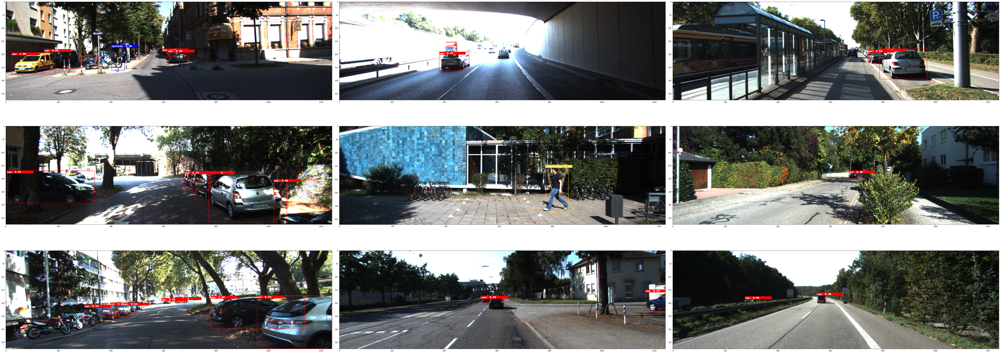

In [ ]:
# Visualizing the sample images.
OUTPUT_PATH = 'ssd_infer_images' # relative path from $USER_EXPERIMENT_DIR.
COLS = 3 # number of columns in the visualizer grid.
IMAGES = 9 # number of images to visualize.

visualize_images(OUTPUT_PATH, num_cols=COLS, num_images=IMAGES)